<a href="https://colab.research.google.com/github/mqquiroz/ICH3424/blob/master/Set_Up_Wind_Driven_Currents.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Simple Model

A simple model of wind driven currents producing a surface setup and deeper counter flow. Since variations in flow with depth are of interest this model is a 2D model using cells with distance in the x-direction and depth in the z-direction.


The model defines the acceleration acting on each cell in terms of the forces of pressure and the shear stress acting at the uper and lower boundaries, i.e.:

$$ \frac{du}{dt} = \left(\frac{1}{\rho}\right)\cdot \frac{d\tau}{dz} - g\cdot\frac{d\eta}{dx} $$

where, \\
$u$ is the horizontal current velocity (m/s) \\
$x$ is the longitudunal distance (m) \\
$z$ is the vertical depth (m) \\
$\eta$ is the water level above some datum (m) \\
$\tau$ is the horizontal shear stress \\
$\rho$ is density of water (kg/m^3) \\
$g$ is the acceleration due to gravity (m/s^2) \\

The height of each cell is updated during each timestep using the continuity equation,

$$ \frac{dh}{dt} = - \frac{d(h.u)}{dx} $$

where, \\
$h$ is the individual cell height

Total water level is determined by vertically summing the individual heights of each cell.

Friction acting on each cell is determined as the rate of change of shear stresses ($\tau$) acting on the upper and lower boundaries,

 $$\frac{d\tau}{dz} = \frac{(\tau[upper] - \tau[lower])}{h}$$

In the general case, $\tau$ is determined by the rate of change of current velocity with depth (i.e. the current shear) multiplied by the eddy viscosity

$$ \tau(x,z) = \nu \cdot \frac{(u[upper] - u[lower])}{h} $$

For the special cases of the upper water surface and the bed, $\tau$ is respectively defined by,

$$ \tau = \rho_{a}\cdot C_{w} \cdot (u_{w} - u_{s})^2 $$

and

$$\tau = \rho_{w} \cdot C_{b} \cdot |u_{b}|u_{b} $$

where \\
$\rho_{a}$ is the density of air \\
$\rho_{w}$ is the density of seawater \\
$C_{w}$ is the drag coefficient of wind \\
$C_{b}$ is the bottom drag coefficient \\
$u_{w}$ is the wind speed \\
$u_{s}$ is the surface current speed \\
$u_{b}$ is the botttom current speed \\



So at the air-water interface, $\tau$ varies with the DIFFERENCE between wind speed and current speed. See http://airsea-www.jpl.nasa.gov/publication/paper/Liu-encyc-2013-stress.pdf for more information on the wind drag formulation.

Note, there is an instability in this model which originates somewhere near the upper x boundary.

In [11]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import animation # libreria para animaciones
from IPython.display import HTML # libreria necesaria para mostrar las animaciones en google colab
import matplotlib as mpl

In [12]:
# %% Set up initial state and global variables

# Numerics
N  = 30       # basin size
dx = 1.0/N    # distance step, i.e. distance between cells
dt = 0.01*dx  # this needs to be quite small otherwise we get negative heights!
              # i.e. water speed too fast, entire cell gets emptied in time step

number_of_depth_intervals = 20

# Physics
h          = 5.0    # height to datum (not the same as 'height' in the model
                    # iteration which represents the total height of the water surface)
mu         = 100    # typical value for eddy viscosity
Cb         = 0.005  # bed drag coefficient
Cw         = 0.0015 # wind drag coefficient
wind_speed = 20
g          = 9.81
da         = 1.2922 # density of air
dw         = 1025.0 # density of water

# %% Initialize containers for local (cell) current velocities (u), water
# heights, shear stresses and water slopes (px).

# The heights of individual cells are tracked but the height of the entire water
# column is required for calculating the pressure gradient and we also use a 1D
# container for this.

u       = np.zeros((number_of_depth_intervals,N+1))
heights = np.zeros((number_of_depth_intervals,N+1))
height  = np.zeros(N+1)
px      = np.zeros((number_of_depth_intervals,N+1))
tau     = np.zeros((number_of_depth_intervals,N+1))

# Each cell initially has a height representing a fraction of the initial, constant
# water depth
heights[:] = h/number_of_depth_intervals


# %% Set up iteration-of-timestep function. We do this, rather than a loop, because
# the animation pattern requires a callable function to drive each timestep

# Iterate one timestep
def step():

    # Update local water heights based on last cell heights
    height = sum(heights)

    # Catch instability and stop animation
    if any(height > h*1.5):
        anim._stop()

    # Calculate shear stress at upper boundary of each cell.

    # Surface cells are handled differently, using the wind stress function
    for x in range(0,N+1):
        tau[0,x] = da * Cw * (wind_speed - u[0,x])**2

    # Shear stress between water cells is a function of the velocity gradient between
    # the two cells
    for z in range(1, number_of_depth_intervals):
        for x in range(0,N+1):
            tau[z,x] = mu * (u[z-1,x] - u[z,x])/heights[z-1,x]

    # Calculate local water slopes
    for z in range(0, number_of_depth_intervals-1):
        for x in range(1,N+1):
            px[z,x] = (height[x] - height[x-1])/dx # water level gradient

    # Calculate local current velocities #

    # New velocities based on momentum equation
    for z in range(0, number_of_depth_intervals-1):
        for x in range(0,N+1):
            u[z,x] = (u[z,x] + dt * (((1.0/dw)*(tau[z,x] - tau[z+1,x])/heights[z,x]) - g * px[z,x]))

    # Calculate current velocities for bottom cell. Note the use of a special term
    # for the bottom shear stress (dw*Cb*u[-1,x]*abs(u[-1,x]))
    for x in range(0,N):
        u[-1,x] = u[-1,x] + dt * (((1.0/dw)*(tau[-1,x] - dw*Cb*u[-1,x]*abs(u[-1,x]))/heights[-1,x]) - g * px[-1,x])

    # Handle velocities at boundaries
    for z in range(0,number_of_depth_intervals):
        u[z,-1] = 0


    for z in range(0,number_of_depth_intervals):
        u[z,0] = 0

    # Calculate new local heights #

    # New heights based on continuity equation
    for z in range(0, number_of_depth_intervals-1):
        for x in range(0,N):
            heights[z,x] = heights[z,x] - dt * ((heights[z,x+1] * u[z,x+1] - heights[z,x]*u[z,x])/dx)

    # Make heights in last column just the same as adjacent column (i.e. no gradient)
    for z in range(0,number_of_depth_intervals):
        heights[z,-1] = heights[z,-2]



# %% Set up animation functions

def init(): # Clear frame on each interation
    speed_line.set_data([], [])
    water_level_line.set_data([], [])

    return speed_line, water_level_line


def animate(i): # Invoke model timestep and replot data on each iteration
    step()

    water_level_line.set_data(range(N+1), sum(heights))
    speed_line.set_data(u[:,19][::-1],np.linspace(0,h,number_of_depth_intervals)) # reverse u data

    return speed_line, water_level_line

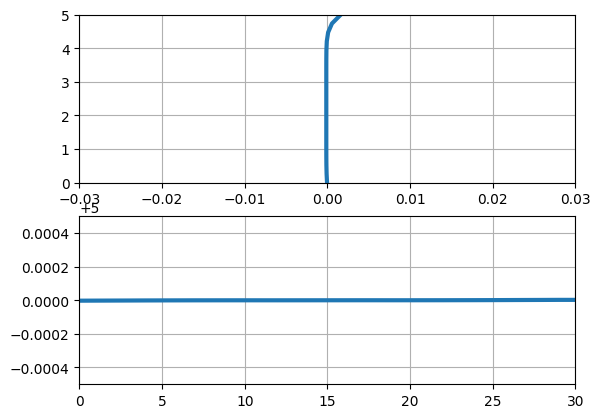

In [14]:
# %% Run!

# Set up figure

fig = plt.figure()

speed_plot = fig.add_subplot(211, xlim=(-wind_speed*Cw, wind_speed*Cw), ylim=(0,h))
water_level_plot = fig.add_subplot(212, xlim=(0,N), ylim=(h*0.9999,h*1.0001))

speed_plot.grid()
water_level_plot.grid()

speed_line, = speed_plot.plot([], [], lw=3)
water_level_line, = water_level_plot.plot([], [], lw=3)


# Run

#anim = animation.FuncAnimation(fig,animate,frames=10000,interval=1,blit=True,init_func=init)
anim = animation.FuncAnimation(fig,animate,frames=2000,interval=1,blit=False,init_func=init)

HTML(anim.to_jshtml())